# analyze casp14 mqa result

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
pd.options.display.float_format = '{:.3f}'.format
plt.rcParams["figure.dpi"] = 150
sns.set(style='darkgrid')
from sklearn.metrics import mean_absolute_error, mean_squared_error
from IPython.display import display

In [2]:
# function for performance evaluation 
def get_loss(target_df, label_name, column_name):
    try:
        loss = target_df[label_name].max() - target_df[label_name][target_df[column_name].idxmax()]
    except TypeError as e:
        loss = None
    return loss

def get_whole_loss(df, label_name: str, column_list: list):
    loss_list = [get_loss(df, label_name, column) for column in column_list]
    return pd.DataFrame({label_name + ' Loss':loss_list}, index=column_list)

def get_mae(df, label_name, column_name):
    df = df.dropna(subset=[column_name])
    try:
        mae = mean_absolute_error(df[label_name], df[column_name])
    except ValueError as e:
        mae = None
    return mae

def get_whole_mae(df, label_name: str, column_list: list):
    mae_list = [get_mae(df, label_name, column) for column in column_list]
    return pd.DataFrame({label_name + ' MAE':mae_list}, index=column_list)

def get_mse(df, label_name, column_name):
    df = df.dropna(subset=[column_name])
    try:
        mse = mean_squared_error(df[label_name], df[column_name])
    except ValueError as e:
        mse = None
    return mse

def get_whole_mse(df, label_name: str, column_list: list):
    mse_list = [get_mse(df, label_name, column) for column in column_list]
    return pd.DataFrame({label_name + ' MSE':mse_list}, index=column_list)

def eval(df, columns, label_name='GDT_TS', threshold=0):
    metrics_array = []
    df = df.groupby('Target').filter(lambda x: x[label_name].max() >= threshold)
    if df[label_name].max() > 1:
        df[label_name] /= 100
    group = df.groupby('Target')
    pearson = group.corr()[label_name].loc[:, columns].rename(label_name + ' Pearson')
    spearman = group.corr(method='spearman')[label_name].loc[:, columns].rename(label_name + ' Spearman')
    loss = group.apply(lambda x: get_whole_loss(x, label_name, columns)) * 100
    mae = group.apply(lambda x: get_whole_mae(x, label_name, columns))
    mse = group.apply(lambda x: get_whole_mse(x, label_name, columns))
    performance_df = pd.concat([pearson, spearman, loss, mae, mse], axis=1).reset_index().rename(columns={'level_1': 'Group'})
    print(len(group))
    return performance_df

In [3]:
# function for visualization
def scatter(df, x='GDT_TS', y='Proposed', col_wrap=4):
    g = sns.relplot(data=df, kind='scatter', x=x, y=y, col='Target', col_wrap=col_wrap)
    g.set(xlim=(0, 100), ylim=(0, 1))
    plt.subplots_adjust(wspace=0.1)

## read mqa score

In [4]:
df = pd.read_csv('../download/data/casp14_stage2.csv', index_col=0)
df = df.dropna(subset=['GDT_TS'])

In [5]:
# filter targets not included in the mqa results table (T1027, T1088) and not define domain classification (T1048, T1062, T1072s1, T1098)
fil_target = ['T1027', 'T1088'] + ['T1048', 'T1062', 'T1072s1', 'T1098']
df_fil = df.groupby('Target').filter(lambda x: x.name not in fil_target)

In [6]:
df_fil

,3DCNN_prof,ProQ3D,GraphQA,angleQA,ProQ2,DAVIS-EMAconsensus,BAKER-ROSETTASERVER,BAKER-experimental,P3De,ModFOLD8,...,MolPrb_ramfv,N1,N2,DIST,N,RMSD,GDT_TS,LGA_S3,LGA_Q,Target
T1024TS075_1,0.661,0.586,0.649,0.467,0.598,0.648,0.678,0.618,0.568,0.582,...,95.320,408.000,391.000,4.000,203.000,2.480,47.059,45.012,7.868,T1024
T1024TS050_4,0.570,0.541,0.579,0.416,0.547,0.624,0.601,0.542,0.532,0.571,...,93.100,408.000,391.000,4.000,224.000,2.690,50.256,48.095,8.024,T1024
T1024TS211_4,0.560,0.532,0.584,0.419,0.541,0.611,0.625,0.592,0.492,0.536,...,84.680,374.000,391.000,4.000,199.000,2.320,46.036,46.466,8.220,T1024
T1024TS367_5,0.698,0.684,0.646,0.601,0.610,0.690,0.743,0.731,0.614,0.579,...,96.800,408.000,391.000,4.000,328.000,2.330,60.934,62.641,13.478,T1024
T1024TS278_1,0.697,0.751,0.716,0.487,0.738,0.683,0.727,0.668,0.703,0.557,...,97.540,408.000,391.000,4.000,289.000,2.260,59.910,55.603,12.245,T1024
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
T1101TS013_5,0.677,0.653,0.719,0.708,0.791,0.518,0.739,0.762,0.625,0.528,...,94.300,318.000,297.000,4.000,172.000,1.940,47.138,43.689,8.418,T1101
T1101TS031_4,0.711,0.603,0.668,0.693,0.666,0.559,0.679,0.661,0.594,0.537,...,90.190,318.000,297.000,4.000,188.000,1.880,51.010,48.073,9.512,T1101
T1101TS140_5,0.690,0.624,0.704,0.762,0.676,0.574,0.701,0.731,0.590,0.563,...,91.140,318.000,297.000,4.000,200.000,2.560,57.239,50.569,7.505,T1101
T1101TS435_4,0.669,0.533,0.666,0.692,0.691,0.546,0.629,0.604,0.549,0.507,...,79.430,318.000,297.000,4.000,168.000,2.400,49.579,43.283,6.709,T1101


In [7]:
target_list = df_fil.groupby('Target').filter(lambda x: x['GDT_TS'].max() > 40)['Target'].unique()
print(target_list, len(target_list))

['T1024' 'T1025' 'T1026' 'T1028' 'T1029' 'T1030' 'T1031' 'T1032' 'T1033'
 'T1034' 'T1035' 'T1036s1' 'T1037' 'T1039' 'T1040' 'T1041' 'T1042' 'T1043'
 'T1045s1' 'T1045s2' 'T1046s1' 'T1046s2' 'T1047s2' 'T1049' 'T1050' 'T1052'
 'T1053' 'T1054' 'T1055' 'T1056' 'T1057' 'T1058' 'T1060s2' 'T1060s3'
 'T1065s1' 'T1065s2' 'T1067' 'T1068' 'T1073' 'T1074' 'T1076' 'T1078'
 'T1079' 'T1080' 'T1082' 'T1083' 'T1084' 'T1085' 'T1086' 'T1087' 'T1089'
 'T1090' 'T1092' 'T1094' 'T1095' 'T1099' 'T1100' 'T1101'] 58


## read domain definitions and classifications

In [8]:
dom_cla_df = pd.read_csv('../download/data/casp14_domain_definitions_and_classifications_fixed.csv', index_col=0)
# delete duplicated target (multidomain)
dom_cla_df = dom_cla_df.drop_duplicates(keep='first', subset='Target')
dom_cla_df

,Target,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
#,,,,,,,,
1,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
3,T1025,268,Server only,T1025-D1: 12-268,257,TBM-easy,6uv6,SingleDomain
4,T1026,172,All groups,T1026-D1: 27-172,146,TBM-hard,6s44,SingleDomain
5,T1027,168,All groups,"T1027-D1: 8-18,34-81,95-134",99,FM,-,SingleDomain
6,T1028,316,Server only,T1028-D1: 16-307,292,TBM-easy,-,SingleDomain
...,...,...,...,...,...,...,...,...
99,T1095,665,All groups,T1095-D1: 1-649,649,TBM-hard,-,SingleDomain
100,T1096,464,All groups,T1096-D0,464,FM,-,MultiDomain
102,T1099,262,All groups,T1099-D1: 11-188,178,TBM-hard,6ygh,SingleDomain


## concat mqa df and domain df

In [9]:
cdf = pd.merge(df_fil, dom_cla_df, on='Target', how='inner')
cdf

,3DCNN_prof,ProQ3D,GraphQA,angleQA,ProQ2,DAVIS-EMAconsensus,BAKER-ROSETTASERVER,BAKER-experimental,P3De,ModFOLD8,...,LGA_S3,LGA_Q,Target,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
0,0.661,0.586,0.649,0.467,0.598,0.648,0.678,0.618,0.568,0.582,...,45.012,7.868,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
1,0.570,0.541,0.579,0.416,0.547,0.624,0.601,0.542,0.532,0.571,...,48.095,8.024,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
2,0.560,0.532,0.584,0.419,0.541,0.611,0.625,0.592,0.492,0.536,...,46.466,8.220,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
3,0.698,0.684,0.646,0.601,0.610,0.690,0.743,0.731,0.614,0.579,...,62.641,13.478,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
4,0.697,0.751,0.716,0.487,0.738,0.683,0.727,0.668,0.703,0.557,...,55.603,12.245,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9889,0.677,0.653,0.719,0.708,0.791,0.518,0.739,0.762,0.625,0.528,...,43.689,8.418,T1101,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain
9890,0.711,0.603,0.668,0.693,0.666,0.559,0.679,0.661,0.594,0.537,...,48.073,9.512,T1101,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain
9891,0.690,0.624,0.704,0.762,0.676,0.574,0.701,0.731,0.590,0.563,...,50.569,7.505,T1101,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain
9892,0.669,0.533,0.666,0.692,0.691,0.546,0.629,0.604,0.549,0.507,...,43.283,6.709,T1101,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain


## performance evaluation

In [10]:
df.columns

Index(['3DCNN_prof', 'ProQ3D', 'GraphQA', 'angleQA', 'ProQ2',
       'DAVIS-EMAconsensus', 'BAKER-ROSETTASERVER', 'BAKER-experimental',
       'P3De', 'ModFOLD8', 'tFold-IDT', 'VoroCNN-GDT', 'VoroCNN-GEMME',
       'DeepPotential', 'Ornate', 'SBROD', 'GR#', 'NP_P', 'RANK', 'Z-M1-GDT',
       'Z-MA-GDT', 'GDT_HA', 'GDC_SC', 'GDC_ALL', 'RMS_CA', 'RMS_ALL', 'NP',
       'err', 'AL0_P', 'AL4_P', 'ALI_P', 'LGA_S', 'RMSD[L]', 'Z-score[M]',
       'Z-Score[D]', 'Al.Res.', 'RMSD[D]', 'MolPrb_Score', 'LDDT', 'SphGr',
       'CAD_AA', 'RPF', 'CODM', 'DFM', 'Handed.', 'SOV', 'CE', 'QCS', 'CONTS',
       'TMscore', 'Dali(raw)', 'FlexE', 'QSE', 'CAD_SS', 'MolPrb_clash',
       'MolPrb_rotout', 'MolPrb_ramout', 'MolPrb_ramfv', 'N1', 'N2', 'DIST',
       'N', 'RMSD', 'GDT_TS', 'LGA_S3', 'LGA_Q', 'Target'],
      dtype='object')

In [11]:
single_model_list = ['3DCNN_prof', 'BAKER-ROSETTASERVER', 'BAKER-experimental', 'ModFOLD8', 'tFold-IDT', 'VoroCNN-GDT', 'GraphQA', 'ProQ3D', 'LDDT']

In [12]:
eval_df = eval(df_fil, columns=single_model_list, threshold=40)
eval_df['order'] = eval_df['Group'].apply(lambda x: single_model_list.index(x))
eval_df = eval_df.sort_values('order')
eval_df.groupby('Group').mean().reset_index().sort_values('order').drop('order', axis=1)

58


,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE
0,3DCNN_prof,0.598,0.560,10.480,0.149,0.034
1,BAKER-ROSETTASERVER,0.662,0.613,8.332,0.117,0.023
2,BAKER-experimental,0.623,0.589,8.378,0.121,0.025
5,ModFOLD8,0.649,0.602,8.496,0.140,0.032
8,tFold-IDT,0.516,0.491,10.758,0.215,0.071
7,VoroCNN-GDT,0.557,0.508,9.707,0.157,0.034
3,GraphQA,0.521,0.482,9.815,0.135,0.030
6,ProQ3D,0.544,0.503,10.767,0.130,0.025
4,LDDT,0.780,0.784,2.121,0.099,0.014


In [13]:
eval_df.groupby('Group').mean().sort_values('GDT_TS Loss')

,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE,order
Group,,,,,,
LDDT,0.780,0.784,2.121,0.099,0.014,8
BAKER-ROSETTASERVER,0.662,0.613,8.332,0.117,0.023,1
BAKER-experimental,0.623,0.589,8.378,0.121,0.025,2
ModFOLD8,0.649,0.602,8.496,0.140,0.032,3
VoroCNN-GDT,0.557,0.508,9.707,0.157,0.034,5
GraphQA,0.521,0.482,9.815,0.135,0.030,6
3DCNN_prof,0.598,0.560,10.480,0.149,0.034,0
tFold-IDT,0.516,0.491,10.758,0.215,0.071,4
ProQ3D,0.544,0.503,10.767,0.130,0.025,7


In [14]:
eval_df

,Target,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE,order
0,T1024,3DCNN_prof,0.631,0.628,3.645,0.090,0.010,0
144,T1042,3DCNN_prof,0.598,0.571,42.572,0.153,0.037,0
378,T1079,3DCNN_prof,0.801,0.764,10.089,0.194,0.043,0
135,T1041,3DCNN_prof,0.750,0.720,14.050,0.219,0.058,0
387,T1080,3DCNN_prof,0.571,0.604,21.993,0.091,0.014,0
...,...,...,...,...,...,...,...,...
220,T1050,LDDT,0.350,0.414,25.621,0.135,0.025,8
301,T1060s3,LDDT,0.899,0.835,1.016,0.034,0.002,8
409,T1083,LDDT,0.782,0.724,1.902,0.115,0.014,8
436,T1086,LDDT,0.835,0.877,5.840,0.247,0.063,8


In [15]:
ceval_df = pd.merge(eval_df, dom_cla_df, on='Target', how='inner')

In [16]:
ceval_df

,Target,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE,order,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
0,T1024,3DCNN_prof,0.631,0.628,3.645,0.090,0.010,0,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
1,T1024,BAKER-ROSETTASERVER,0.750,0.698,3.645,0.156,0.026,1,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
2,T1024,BAKER-experimental,0.631,0.664,5.179,0.122,0.017,2,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
3,T1024,ModFOLD8,0.495,0.530,9.271,0.039,0.002,3,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
4,T1024,tFold-IDT,0.647,0.622,3.645,0.118,0.016,4,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
517,T1095,tFold-IDT,-0.092,-0.072,25.039,0.221,0.062,4,665,All groups,T1095-D1: 1-649,649,TBM-hard,-,SingleDomain
518,T1095,VoroCNN-GDT,0.138,0.096,9.067,0.116,0.020,5,665,All groups,T1095-D1: 1-649,649,TBM-hard,-,SingleDomain
519,T1095,GraphQA,0.374,0.352,2.662,0.061,0.006,6,665,All groups,T1095-D1: 1-649,649,TBM-hard,-,SingleDomain
520,T1095,ProQ3D,0.053,0.051,23.380,0.090,0.016,7,665,All groups,T1095-D1: 1-649,649,TBM-hard,-,SingleDomain


## basic information of casp14

In [17]:
proposed_result_df = ceval_df.query('Group == "3DCNN_prof"')

In [18]:
proposed_result_df['Classification'].value_counts().sort_index()

FM          13
FM/TBM      11
TBM-easy    12
TBM-hard    22
Name: Classification, dtype: int64

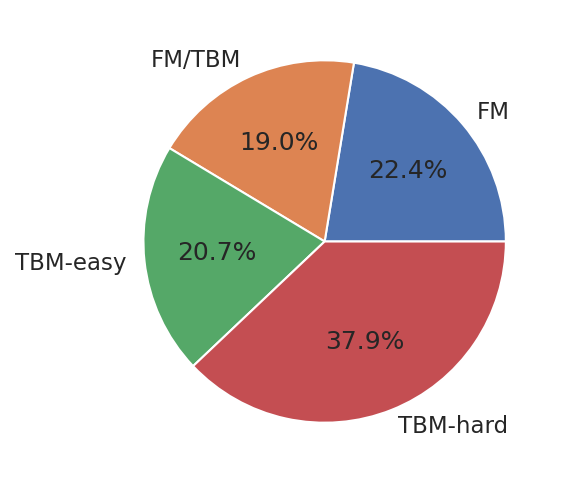

In [19]:
count = proposed_result_df['Classification'].value_counts().sort_index()
label = count.index
plt.pie(count.values, labels=label, autopct='%1.1f%%')
plt.show()

In [20]:
proposed_result_df['Domain'].value_counts()

SingleDomain    45
MultiDomain     13
Name: Domain, dtype: int64

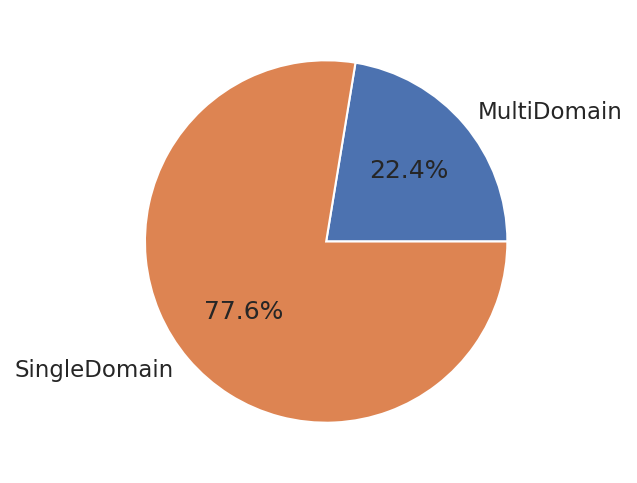

In [21]:
count = proposed_result_df['Domain'].value_counts().sort_index()
label = count.index
plt.pie(count.values, labels=label, autopct='%1.1f%%')
plt.show()

<AxesSubplot:xlabel='Residues in domain'>

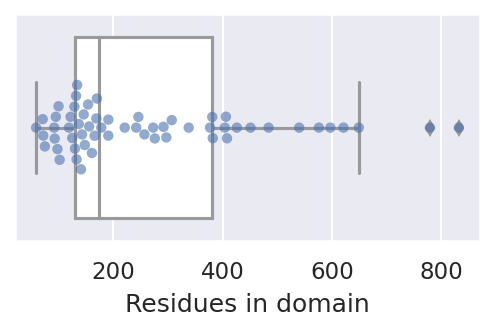

In [22]:
plt.figure(figsize=(4, 2))
sns.boxplot(data=proposed_result_df, x='Residues in domain', color='white')
sns.swarmplot(data=proposed_result_df, x='Residues in domain', alpha=0.6)

In [23]:
# boxplot and swarmplot for each group
def plot_metrics_group(df, metrics, hue=None, figsize=(8, 6), pointsize=4):
    plt.figure(figsize=figsize)
    sns.boxplot(data=df, x=metrics, y='Group', orient='h', color='white')
    sns.swarmplot(data=df, x=metrics, y='Group', orient='h', hue=hue, size=pointsize, palette='Set2')
    plt.tight_layout()

### GDT_TS loss for each group

In [24]:
ceval_df['order'] = ceval_df['Group'].apply(lambda x: single_model_list.index(x))
ceval_df = ceval_df.sort_values('order')

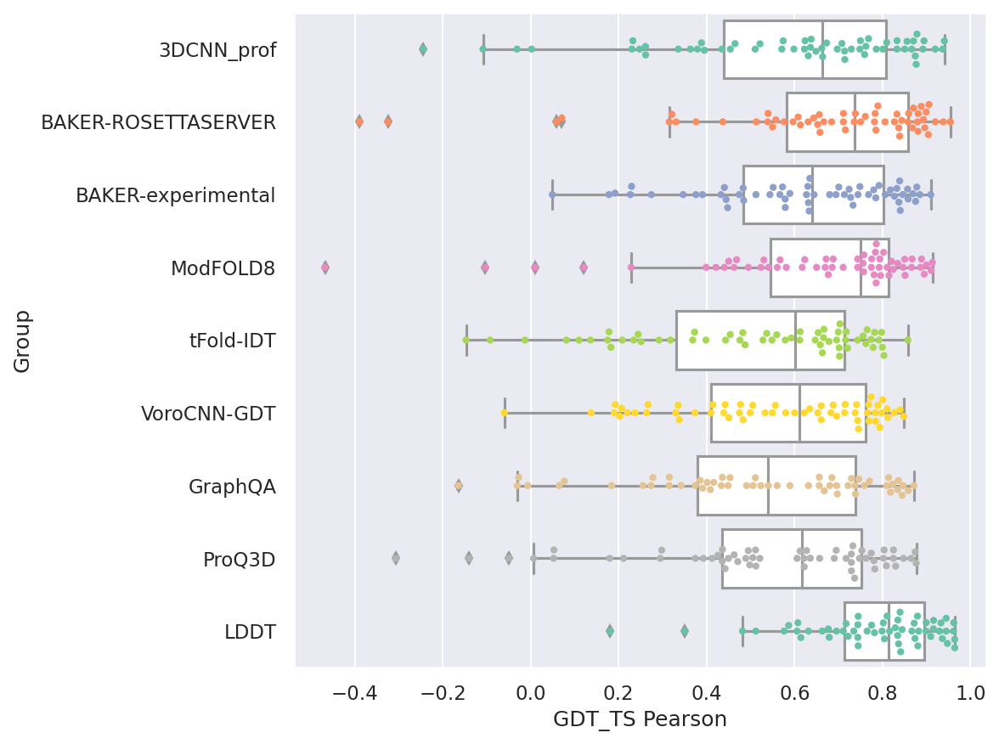

In [25]:
metrics = 'GDT_TS Pearson'
hue = None
plot_metrics_group(ceval_df, metrics, hue)

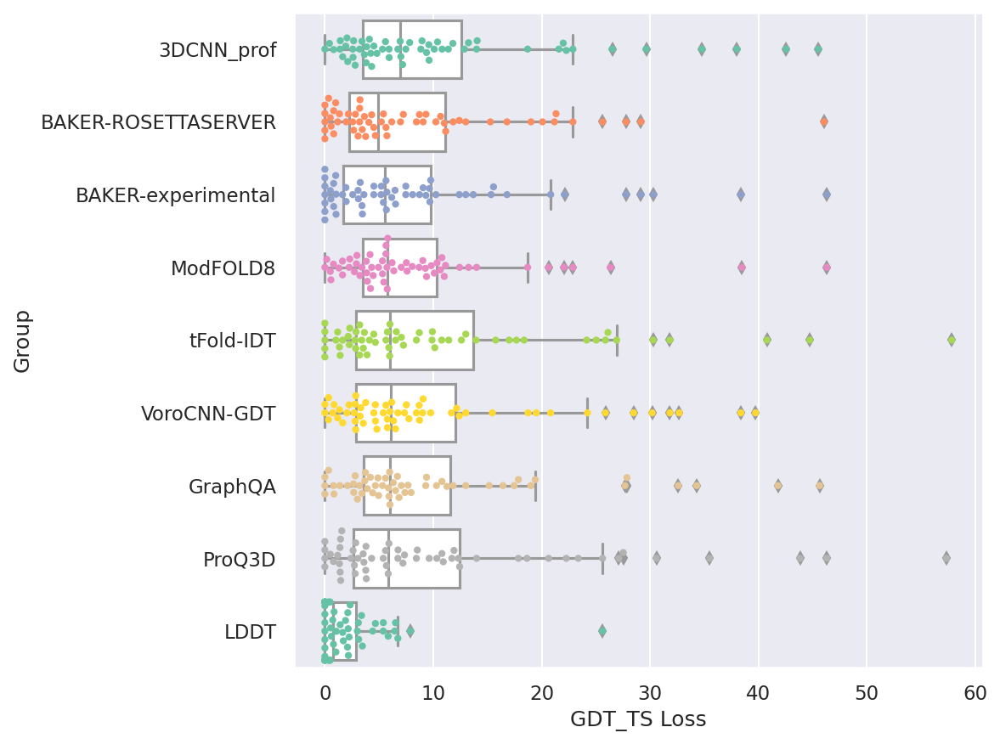

In [26]:
metrics = 'GDT_TS Loss'
hue = None
plot_metrics_group(ceval_df, metrics, hue)

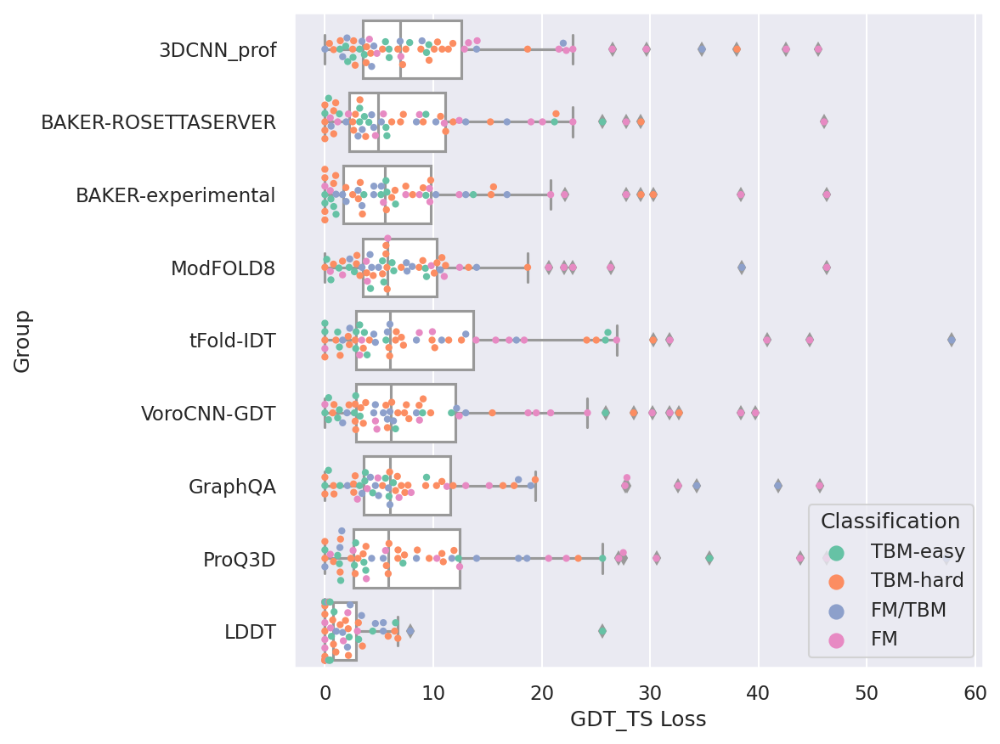

In [27]:
metrics = 'GDT_TS Loss'
hue = 'Classification'
plot_metrics_group(ceval_df, metrics, hue)
# plt.savefig('../download/data/plot/casp14_gdtts_loss_boxplot_class.png')

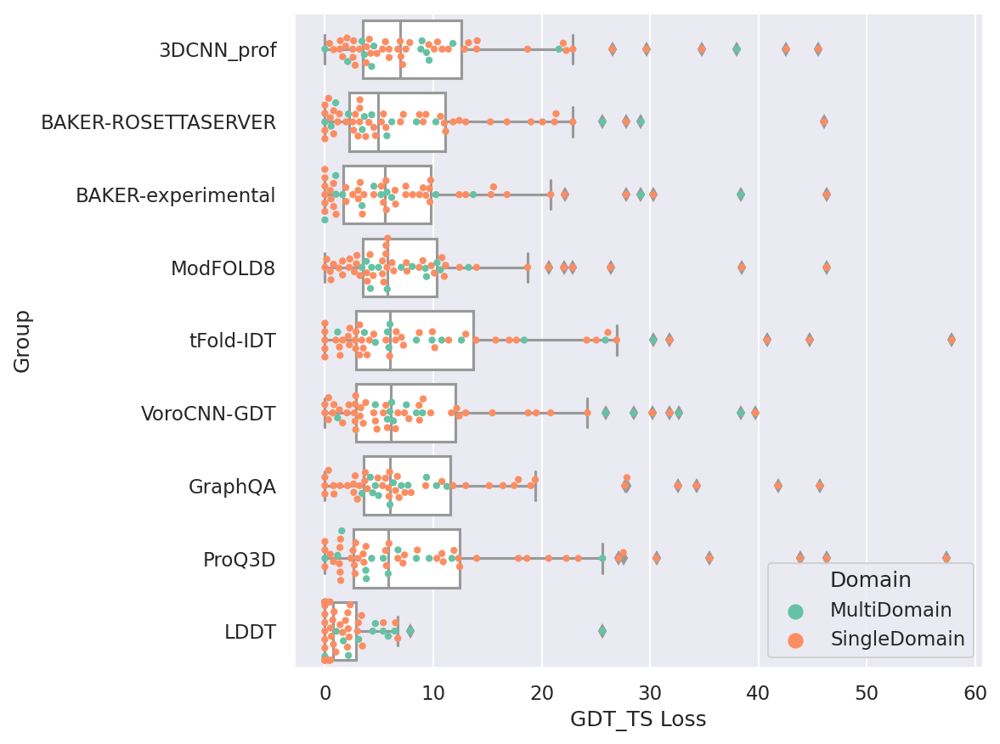

In [28]:
metrics = 'GDT_TS Loss'
hue = 'Domain'
plot_metrics_group(ceval_df, metrics=metrics, hue=hue)
# plt.savefig('../download/data/plot/casp14_gdtts_loss_boxplot_domain.png')

### Pearson for each group

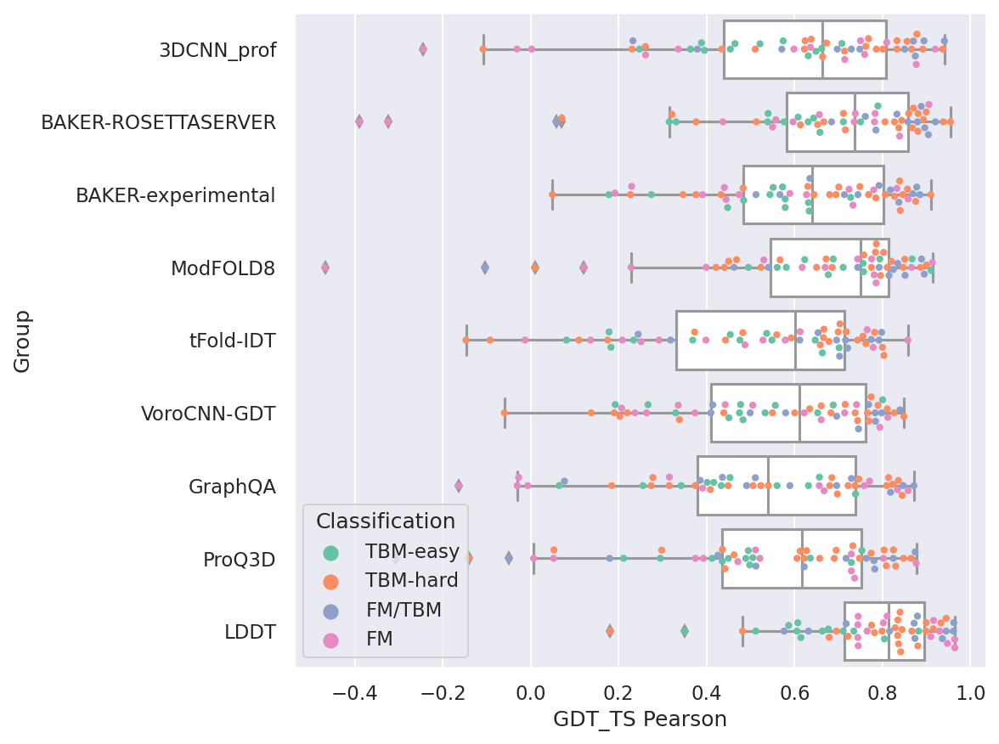

In [29]:
metrics = 'GDT_TS Pearson'
hue = 'Classification'
plot_metrics_group(ceval_df, metrics, hue)
# plt.savefig('../download/data/plot/casp14_gdtts_pearson_boxplot_class.png')

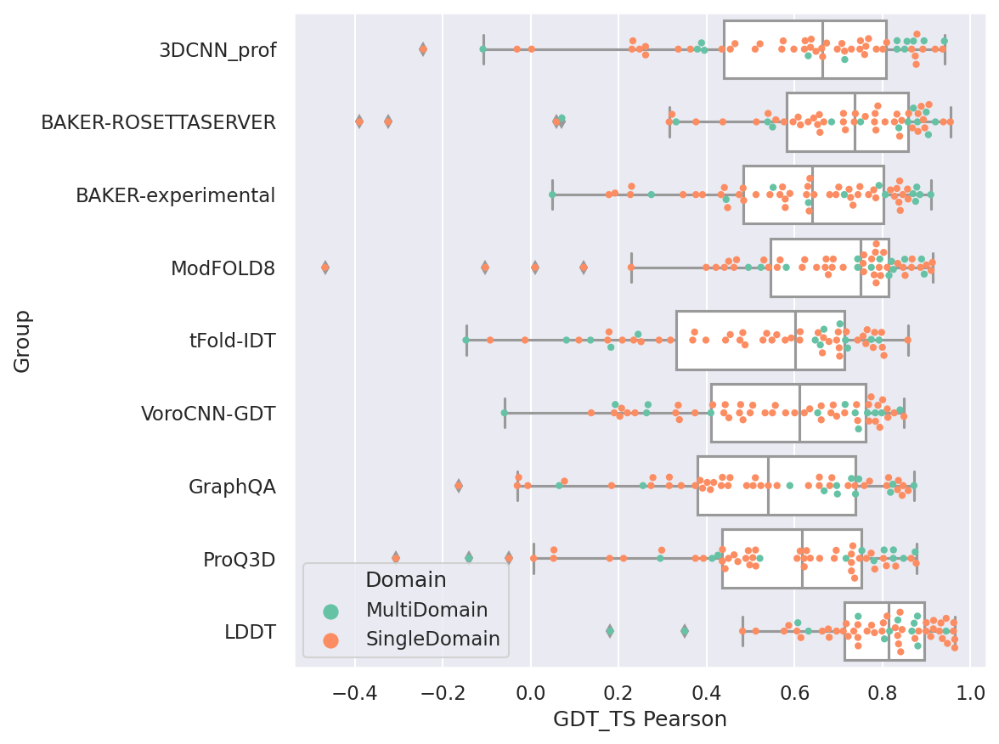

In [30]:
metrics = 'GDT_TS Pearson'
hue = 'Domain'
plot_metrics_group(ceval_df, metrics, hue)
# plt.savefig('../download/data/plot/casp14_gdtts_pearson_boxplot_domain.png')

### MAE for each group

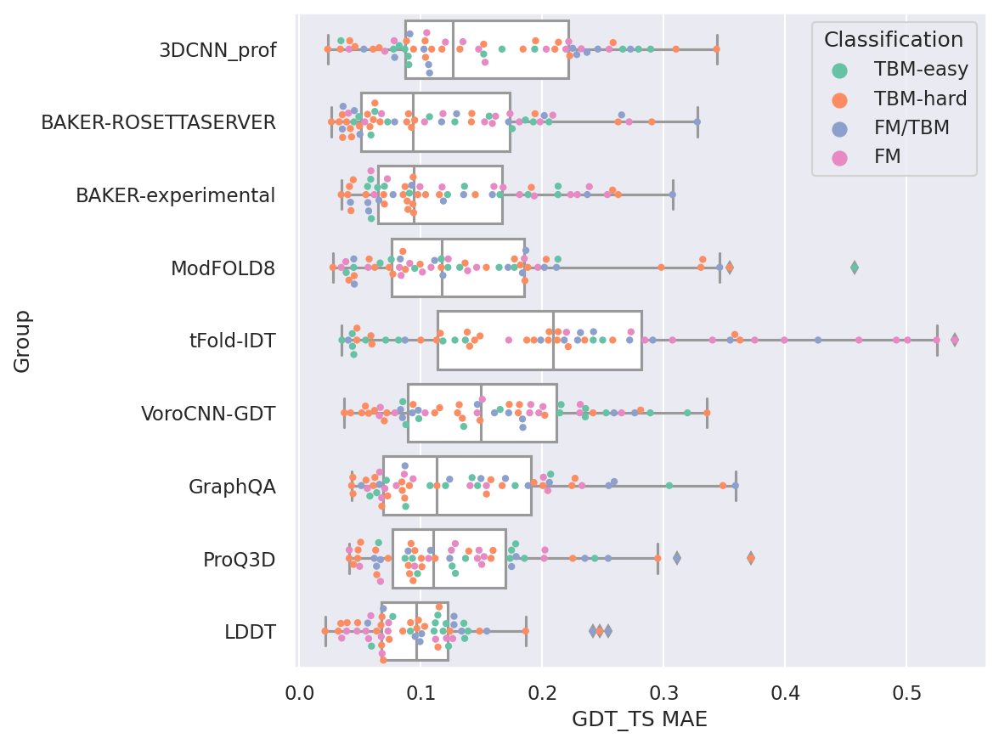

In [31]:
metrics = 'GDT_TS MAE'
hue = 'Classification'
plot_metrics_group(ceval_df, metrics, hue)
# plt.savefig('../download/data/plot/casp14_gdtts_mae_boxplot_class.png')

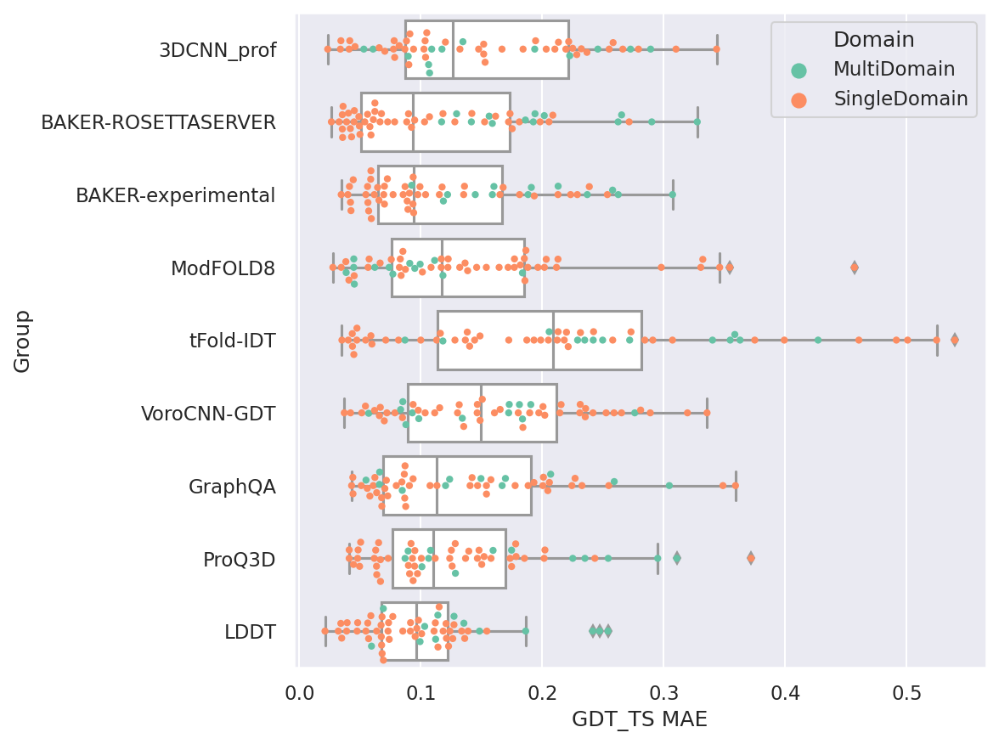

In [32]:
metrics = 'GDT_TS MAE'
hue = 'Domain'
plot_metrics_group(ceval_df, metrics, hue)
# plt.savefig('../download/data/plot/casp14_mae_pearson_boxplot_domain.png')

In [33]:
for name, group in ceval_df.groupby('Classification'):
    print(name, len(group.groupby('Target')))
    display(group.groupby('Group').mean().drop(['Residues', 'Residues in domain'], axis=1).sort_values('order').drop(['order', 'GDT_TS Spearman', 'GDT_TS MAE', 'GDT_TS MSE'], axis=1))

FM 13


,GDT_TS Pearson,GDT_TS Loss
Group,,
3DCNN_prof,0.491,20.548
BAKER-ROSETTASERVER,0.528,13.991
BAKER-experimental,0.563,16.098
ModFOLD8,0.536,14.398
tFold-IDT,0.452,18.048
VoroCNN-GDT,0.516,19.542
GraphQA,0.419,16.655
ProQ3D,0.454,19.508
LDDT,0.845,0.589


FM/TBM 11


,GDT_TS Pearson,GDT_TS Loss
Group,,
3DCNN_prof,0.708,9.331
BAKER-ROSETTASERVER,0.770,6.506
BAKER-experimental,0.750,5.945
ModFOLD8,0.686,9.586
tFold-IDT,0.639,12.056
VoroCNN-GDT,0.665,6.358
GraphQA,0.586,13.106
ProQ3D,0.585,12.788
LDDT,0.834,3.098


TBM-easy 12


,GDT_TS Pearson,GDT_TS Loss
Group,,
3DCNN_prof,0.505,4.925
BAKER-ROSETTASERVER,0.591,6.941
BAKER-experimental,0.517,4.339
ModFOLD8,0.702,4.430
tFold-IDT,0.423,6.387
VoroCNN-GDT,0.492,5.425
GraphQA,0.450,3.997
ProQ3D,0.492,8.132
LDDT,0.646,3.761


TBM-hard 22


,GDT_TS Pearson,GDT_TS Loss
Group,,
3DCNN_prof,0.658,8.134
BAKER-ROSETTASERVER,0.727,6.661
BAKER-experimental,0.653,7.236
ModFOLD8,0.668,6.682
tFold-IDT,0.542,8.187
VoroCNN-GDT,0.563,7.905
GraphQA,0.583,7.232
ProQ3D,0.604,6.029
LDDT,0.787,1.643


### correlation between each group

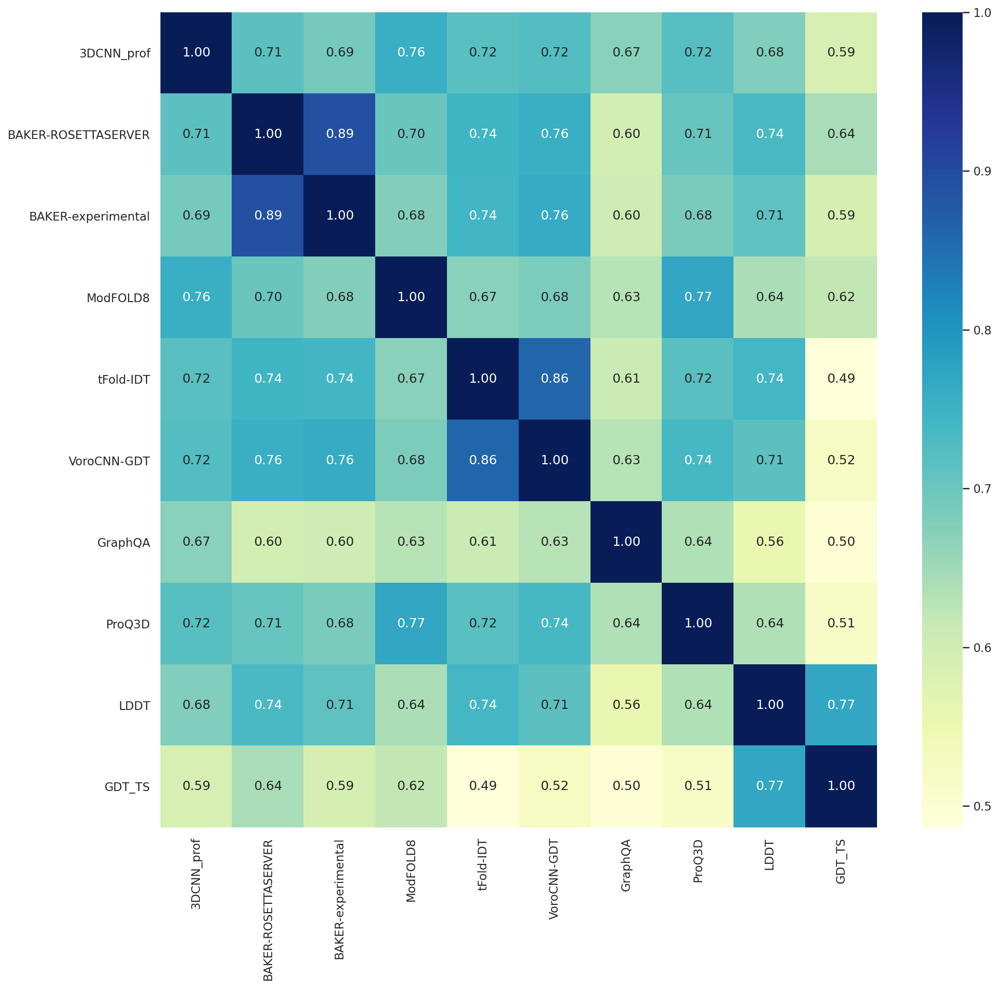

In [34]:
plt.figure(figsize=(14, 13))
sns.heatmap(df[single_model_list + ['GDT_TS', 'Target']].groupby('Target').corr().mean(level=1), cmap='YlGnBu', annot=True, fmt='.2f')
plt.tight_layout()
plt.savefig('../download/data/plot/casp14_mean_correlation_group.png')

# analyze 3DCNN_prof

In [35]:
df.groupby('Target').groups.keys()

dict_keys(['T1024', 'T1025', 'T1026', 'T1027', 'T1028', 'T1029', 'T1030', 'T1031', 'T1032', 'T1033', 'T1034', 'T1035', 'T1036s1', 'T1037', 'T1038', 'T1039', 'T1040', 'T1041', 'T1042', 'T1043', 'T1045s1', 'T1045s2', 'T1046s1', 'T1046s2', 'T1047s1', 'T1047s2', 'T1048', 'T1049', 'T1050', 'T1052', 'T1053', 'T1054', 'T1055', 'T1056', 'T1057', 'T1058', 'T1060s2', 'T1060s3', 'T1061', 'T1062', 'T1064', 'T1065s1', 'T1065s2', 'T1067', 'T1068', 'T1070', 'T1072s1', 'T1073', 'T1074', 'T1076', 'T1078', 'T1079', 'T1080', 'T1082', 'T1083', 'T1084', 'T1085', 'T1086', 'T1087', 'T1088', 'T1089', 'T1090', 'T1091', 'T1092', 'T1093', 'T1094', 'T1095', 'T1096', 'T1098', 'T1099', 'T1100', 'T1101'])

In [36]:
df.query('Target == "T1098"').sort_index()['GDT_TS']

T1098TS013_1   44.279
T1098TS013_2   44.108
T1098TS013_3   44.165
T1098TS013_4   44.508
T1098TS013_5   45.595
                ...  
T1098TS487_1   48.913
T1098TS487_2   48.455
T1098TS487_3   48.741
T1098TS487_4   49.199
T1098TS487_5   49.542
Name: GDT_TS, Length: 150, dtype: float64

In [37]:
ceval_df.query('Group=="3DCNN_prof"').sort_values('GDT_TS Pearson', ascending=True)

,Target,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE,order,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
198,T1031,3DCNN_prof,-0.244,-0.186,45.527,0.203,0.063,0,95,All groups,T1031-D1: 1-95,95,FM,6vr4,SingleDomain
414,T1092,3DCNN_prof,-0.108,-0.159,38.029,0.109,0.016,0,426,All groups,T1092-D0,426,TBM-hard,-,MultiDomain
153,T1033,3DCNN_prof,-0.031,0.048,13.250,0.105,0.015,0,100,All groups,T1033-D1: 1-100,100,FM,6vr4,SingleDomain
207,T1043,3DCNN_prof,0.002,0.270,26.520,0.070,0.010,0,148,All groups,T1043-D1: 1-148,148,FM,6vr4,SingleDomain
513,T1095,3DCNN_prof,0.230,0.228,3.858,0.094,0.011,0,665,All groups,T1095-D1: 1-649,649,TBM-hard,-,SingleDomain
117,T1035,3DCNN_prof,0.232,0.203,34.804,0.228,0.077,0,102,All groups,T1035-D1: 1-102,102,FM/TBM,6vr4,SingleDomain
162,T1089,3DCNN_prof,0.248,0.294,7.825,0.078,0.008,0,404,All groups,T1089-D1: 28-404,377,TBM-easy,-,SingleDomain
144,T1087,3DCNN_prof,0.261,0.452,0.807,0.104,0.018,0,186,All groups,T1087-D1: 1-93,93,TBM-hard,-,SingleDomain
63,T1039,3DCNN_prof,0.261,0.385,29.658,0.120,0.019,0,161,All groups,T1039-D1: 1-161,161,FM,6vr4,SingleDomain
45,T1040,3DCNN_prof,0.336,0.348,22.885,0.078,0.009,0,130,All groups,T1040-D1: 1-130,130,FM,6vr4,SingleDomain


In [38]:
# compared to LDDT
ceval_df.query('Group=="LDDT"')#.sort_values('GDT_TS Pearson', ascending=True)

,Target,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE,order,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
485,T1099,LDDT,0.695,0.704,3.090,0.069,0.007,8,262,All groups,T1099-D1: 11-188,178,TBM-hard,6ygh,SingleDomain
512,T1026,LDDT,0.933,0.925,0.000,0.067,0.006,8,172,All groups,T1026-D1: 27-172,146,TBM-hard,6s44,SingleDomain
476,T1094,LDDT,0.745,0.658,1.704,0.112,0.017,8,496,All groups,T1094-D0: 1-484,484,FM,-,MultiDomain
503,T1029,LDDT,0.744,0.705,3.000,0.055,0.004,8,125,All groups,T1029-D1: 1-125,125,FM,6uf2,SingleDomain
494,T1100,LDDT,0.880,0.863,6.441,0.103,0.013,8,338,All groups,T1100-D0,338,TBM-hard,-,MultiDomain
260,T1058,LDDT,0.816,0.644,4.658,0.069,0.007,8,382,All groups,T1058-D0: 1-382,382,FM/TBM,-,MultiDomain
458,T1025,LDDT,0.711,0.871,2.238,0.111,0.015,8,268,Server only,T1025-D1: 12-268,257,TBM-easy,6uv6,SingleDomain
197,T1036s1,LDDT,0.512,0.356,6.518,0.118,0.021,8,818,Server only,T1036s1-D1: 1-621,621,TBM-easy,6vn1,SingleDomain
188,T1090,LDDT,0.929,0.941,0.529,0.035,0.002,8,193,All groups,T1090-D1: 2-192,191,FM,-,SingleDomain
179,T1032,LDDT,0.799,0.792,0.000,0.021,0.001,8,284,All groups,T1032-D1: 100-269,170,TBM-hard,6n64,SingleDomain


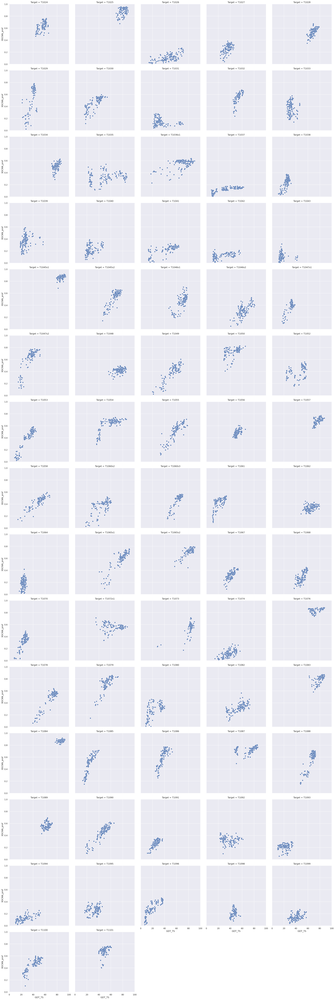

In [39]:
scatter(df, x='GDT_TS', y='3DCNN_prof', col_wrap=5)
# plt.savefig('../download/data/plot/casp14_gdtts_3dcnnprof_scatter.png')

In [40]:
df

,3DCNN_prof,ProQ3D,GraphQA,angleQA,ProQ2,DAVIS-EMAconsensus,BAKER-ROSETTASERVER,BAKER-experimental,P3De,ModFOLD8,...,MolPrb_ramfv,N1,N2,DIST,N,RMSD,GDT_TS,LGA_S3,LGA_Q,Target
T1024TS075_1,0.661,0.586,0.649,0.467,0.598,0.648,0.678,0.618,0.568,0.582,...,95.320,408.000,391.000,4.000,203.000,2.480,47.059,45.012,7.868,T1024
T1024TS050_4,0.570,0.541,0.579,0.416,0.547,0.624,0.601,0.542,0.532,0.571,...,93.100,408.000,391.000,4.000,224.000,2.690,50.256,48.095,8.024,T1024
T1024TS211_4,0.560,0.532,0.584,0.419,0.541,0.611,0.625,0.592,0.492,0.536,...,84.680,374.000,391.000,4.000,199.000,2.320,46.036,46.466,8.220,T1024
T1024TS367_5,0.698,0.684,0.646,0.601,0.610,0.690,0.743,0.731,0.614,0.579,...,96.800,408.000,391.000,4.000,328.000,2.330,60.934,62.641,13.478,T1024
T1024TS278_1,0.697,0.751,0.716,0.487,0.738,0.683,0.727,0.668,0.703,0.557,...,97.540,408.000,391.000,4.000,289.000,2.260,59.910,55.603,12.245,T1024
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
T1101TS013_5,0.677,0.653,0.719,0.708,0.791,0.518,0.739,0.762,0.625,0.528,...,94.300,318.000,297.000,4.000,172.000,1.940,47.138,43.689,8.418,T1101
T1101TS031_4,0.711,0.603,0.668,0.693,0.666,0.559,0.679,0.661,0.594,0.537,...,90.190,318.000,297.000,4.000,188.000,1.880,51.010,48.073,9.512,T1101
T1101TS140_5,0.690,0.624,0.704,0.762,0.676,0.574,0.701,0.731,0.590,0.563,...,91.140,318.000,297.000,4.000,200.000,2.560,57.239,50.569,7.505,T1101
T1101TS435_4,0.669,0.533,0.666,0.692,0.691,0.546,0.629,0.604,0.549,0.507,...,79.430,318.000,297.000,4.000,168.000,2.400,49.579,43.283,6.709,T1101


In [41]:
stack_df = df.stack().reset_index(level=1).rename({'level_1': 'Method', 0: 'Score'}, axis=1)
stack_df

,Method,Score
T1024TS075_1,3DCNN_prof,0.661
T1024TS075_1,ProQ3D,0.586
T1024TS075_1,GraphQA,0.649
T1024TS075_1,angleQA,0.467
T1024TS075_1,ProQ2,0.598
...,...,...
T1101TS337_4,RMSD,2.070
T1101TS337_4,GDT_TS,52.946
T1101TS337_4,LGA_S3,45.451
T1101TS337_4,LGA_Q,8.419


In [42]:
convert_df = pd.merge(stack_df, df[['GDT_TS', 'Target']], left_index=True, right_index=True, how='inner')
convert_df

,Method,Score,GDT_TS,Target
T1024TS013_1,3DCNN_prof,0.719,57.545,T1024
T1024TS013_1,ProQ3D,0.720,57.545,T1024
T1024TS013_1,GraphQA,0.678,57.545,T1024
T1024TS013_1,angleQA,0.501,57.545,T1024
T1024TS013_1,ProQ2,0.745,57.545,T1024
...,...,...,...,...
T1101TS487_5,RMSD,1.870,55.387,T1101
T1101TS487_5,GDT_TS,55.387,55.387,T1101
T1101TS487_5,LGA_S3,51.160,55.387,T1101
T1101TS487_5,LGA_Q,9.790,55.387,T1101


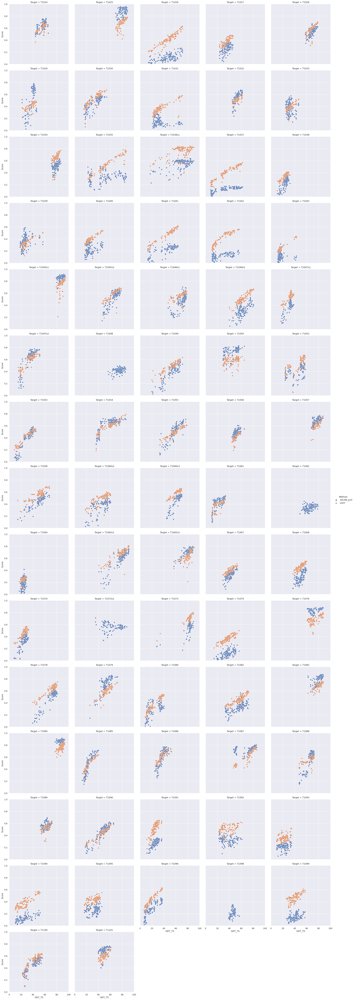

In [43]:
x = 'GDT_TS'
y = 'Score'
compare_method_list = ['3DCNN_prof', 'LDDT']
g = sns.relplot(data=convert_df.query('Method in @compare_method_list'), kind='scatter', x=x, y=y, hue='Method', col='Target', col_wrap=5)
g.set(xlim=(0, 100), ylim=(0, 1))
plt.subplots_adjust(wspace=0.1)
# plt.savefig('../download/data/plot/casp14_gdtts_3dcnnprof_lddt_scatter.png')

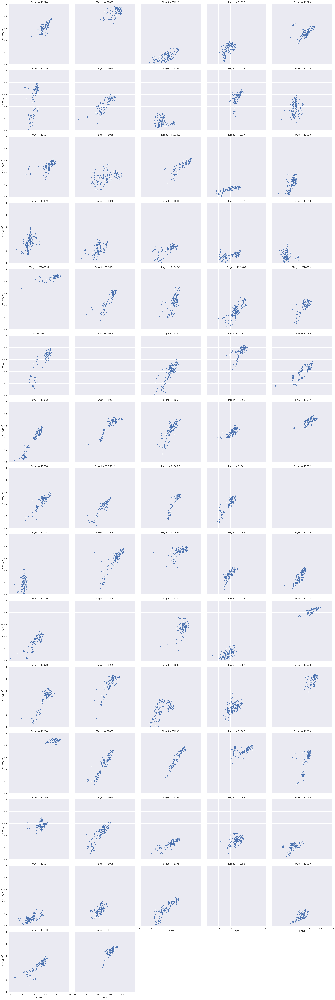

In [44]:
x = 'LDDT'
y = '3DCNN_prof'
g = sns.relplot(data=df, kind='scatter', x=x, y=y, col='Target', col_wrap=5)
g.set(xlim=(0, 1), ylim=(0, 1))
plt.subplots_adjust(wspace=0.1)
# plt.savefig('../download/data/plot/casp14_lddt_3dcnnprof_scatter.png')

In [45]:
eval(df, columns=single_model_list, label_name='LDDT').groupby('Group').mean()

68


,LDDT Pearson,LDDT Spearman,LDDT Loss,LDDT MAE,LDDT MSE
Group,,,,,
3DCNN_prof,0.677,0.643,7.529,0.130,0.025
BAKER-ROSETTASERVER,0.735,0.716,4.060,0.079,0.010
BAKER-experimental,0.713,0.698,4.881,0.086,0.012
GraphQA,0.556,0.524,8.556,0.111,0.020
LDDT,1.000,1.000,0.000,0.000,0.000
ModFOLD8,0.639,0.575,7.015,0.126,0.025
ProQ3D,0.635,0.604,6.368,0.079,0.010
VoroCNN-GDT,0.713,0.673,4.676,0.093,0.013
tFold-IDT,0.739,0.686,5.176,0.204,0.057
